# SIT744 Assignment 2: Deep Learning Project 

<div class="alert-info">
    <p>Due: <strong>8:00pm 16 May 2022</strong>  (Monday)</p>

This is an <strong>individual</strong> assignment. It contributes <strong>40%</strong> to your final mark. Read the assignment instruction carefully.

<h2> What to submit </h2>

<p>
This assignment is to be completed individually and submitted to CloudDeakin. <strong>By the due date, you are required to submit the following files to the corresponding Assignment (Dropbox) in CloudDeakin</strong>:

<ol>
<li>	<strong>[YourID]_assignment2_solution.ipynb</strong>:  This is your Python notebook solution source file. </li>
<li>	<strong>[YourID]_assingment2_output.html</strong> or <strong>[YourID]_assingment2_output.pdf</strong>: This is the output of your Python notebook solution <emph>exported</emph> in HTML or PDF format.</li>
<li>	Extra files needed to complete your assignment, if any (e.g., images used in your answers).</li>
</ol>
</p>

<p>
For example, if your student ID is: 123456, you will then need to submit the following files:
<ul>
<li> 123456_assignment2_solution.ipynb </li>
<li> 123456_assignment2_output.html</li>
</ul>
</p>

<h2> Warning </h2>

Some components of this assignment may involve heavy computation that runs for a long duration. Please start early to avoid missing the assignment due date.

<h2> Marking criteria </h2>

<p>
Your submission will be assessed based on the overall impact of your effort. A useful model (or application) should be your focus. But as in Assignment 1, we will also consider the following criteria at the same time.

<ul>
<li> Showing good effort through completed tasks.</li>
<li> Applying deep learning theory to design suitable deep learning solutions for the tasks.</li>
<li> Critically evaluating and reflecting on the pros and cons of various design decisions.</li>
<li> Demonstrating creativity and resourcefulness in providing unique individual solutions.</li>
<li> Showing attention to detail through a good quality assignment report.</li>
</ul>
</p>


</div>

## Assignment objective

This assignment is to feedback on your learning in deep learning theory and its application to  data analytics or artificial intelligence problems.  

It builds on Assignment 1 but requires a higher level of mastery of deep learning theory and programming/engineering skills. In particular, you will practice making design decisions yourself. You are also likely to encounter practical issues that will help you consolidate textbook learning. 

## **Task 1 (P Task) Smart Recycling using Deep Learning**

In Assignment 1, you tackled the image classification problem in Fashion-MNIST. There, you used a Densely Connected Neural Network. In Assignment 2, you will apply the best practices of deep-learning computer vision to make something useful for our planet—waste classification.

**Background** Every day, we put things into our recycle bin, to reduce landfill waste. However, we may unintentionally contribute to [recycling contamination](https://www.cleanaway.com.au/sustainable-future/contamination-main/) by "wish recycling" the wrong items. As every city council has slightly different rules for recycling, you will build a technological solution to ensure you only recycle things that are permitted by your local council. More discussions about recycling contamination can be found [here](https://www.cleanup.org.au/recycle).
![Recycling rule of a local council (source: Whitehorse City Council)](https://www.whitehorse.vic.gov.au/sites/whitehorse.vic.gov.au/files/assets/images/Recycle%20Right%20A3%20Poster.jpg "Recycling rule of a local council")

### Task 1.1 Define a problem

Define an image classification problem that may help people better recycle, particularly by reducing contamination.

Describe the desired inputs and outputs, including the target classes.



### Task 1.2 Make a plan

What dataset can you use to develop a deep learning solution?

How many images do you need? How many for training? How many for testing?

Do you need to label the images yourself?

How do you determine if your model is good enough?

### Task 1.3 Implement a solution

Collect relevant data.
Develop a deep learning model.
Report the model performance against the success criteria that you define.












#Task 1.1 Response:
I live in Geelong where the City Of Greater Geelong has a helpful guide on what items can be recycled. See link: https://www.geelongaustralia.com.au/recycling/guide/default.aspx 

As a summary of what can and can't be recycled:
![Recycling rule of City Of Greater Geelong (source: City of Greater Geelong)](https://www.geelongaustralia.com.au/common/public/images/lrg/8d77d532f9653ea-Recycling%20guide.jpg "Recycling rules")

For my desired dataset, I will use colours images of common household rubbish and output 5 targets classes: plastic, paper, cardboard, metal, glass and trash.


#Task 1.2 Response
1. What dataset can you use to develop a deep learning solution?

I have combined 2 datasets from gitHub, Trashbox (https://github.com/nikhilvenkatkumsetty/TrashBox) and Trashnet (https://github.com/garythung/trashnet). I decided upon this as I wanted a greater set of images to work with than what Trashnet offered.

2. How many images do you need? How many for training? How many for testing?

By combining the 2 datasets I have 5996 images in total. I have split the data to 60% training, 20% validation and 20% testing.

3. Do you need to label the images yourself?

As Trashnet contained the labels I had needed for classification, I had only needed to change the Trashbox labels to fit into the already implemented Trashnet Labels.

4. How do you determine if your model is good enough?

I am aiming for good performance on the validation dataset to ensure that overfitting hasn't occurred on the training dataset. This will allow for the best results when evaluating the model on the testing dataset.

In [ ]:
import zipfile
import os

In [ ]:
#remove folder of data if need to reset dataset
#%rm -rf /tmp/dataset-resized/

In [ ]:
#get trashbox data from github

!wget --no-check-certificate \
    "https://github.com/nikhilvenkatkumsetty/TrashBox-testandvalid/archive/refs/heads/main.zip" \
    -O "/tmp/trash.zip"


zip_ref = zipfile.ZipFile('/tmp/trash.zip', 'r') #Opens the zip file in read mode
zip_ref.extractall('/tmp') #Extracts the files into the /tmp folder
zip_ref.close()

--2022-09-14 03:17:40--  https://github.com/nikhilvenkatkumsetty/TrashBox-testandvalid/archive/refs/heads/main.zip
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://codeload.github.com/nikhilvenkatkumsetty/TrashBox-testandvalid/zip/refs/heads/main [following]
--2022-09-14 03:17:40--  https://codeload.github.com/nikhilvenkatkumsetty/TrashBox-testandvalid/zip/refs/heads/main
Resolving codeload.github.com (codeload.github.com)... 140.82.114.9
Connecting to codeload.github.com (codeload.github.com)|140.82.114.9|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1063275246 (1014M) [application/zip]
Saving to: ‘/tmp/trash.zip’

/tmp/trash.zip      100%[===================>]   1014M   111MB/s    in 9.7s    

2022-09-14 03:17:50 (104 MB/s) - ‘/tmp/trash.zip’ saved [1063275246/1063275246]



In [ ]:
#test data was imported
print('Trash test cardboard' , len(os.listdir('/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/test/cardboard')))

Trash test cardboard 242


In [ ]:
#get trashnet dataset from github

!wget --no-check-certificate \
    "https://github.com/garythung/trashnet/raw/master/data/dataset-resized.zip" \
    -O "/tmp/trash2.zip"


zip_ref = zipfile.ZipFile('/tmp/trash2.zip', 'r') #Opens the zip file in read mode
zip_ref.extractall('/tmp') #Extracts the files into the /tmp folder
zip_ref.close()

--2022-09-14 03:19:16--  https://github.com/garythung/trashnet/raw/master/data/dataset-resized.zip
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/garythung/trashnet/master/data/dataset-resized.zip [following]
--2022-09-14 03:19:16--  https://raw.githubusercontent.com/garythung/trashnet/master/data/dataset-resized.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 42834870 (41M) [application/zip]
Saving to: ‘/tmp/trash2.zip’

/tmp/trash2.zip     100%[===================>]  40.85M   198MB/s    in 0.2s    

2022-09-14 03:19:17 (198 MB/s) - ‘/tmp/trash2.zip’ saved [42834870/42834870]



In [ ]:
#test trashnet data was imported

print('cardboard in dataset' , len(os.listdir('/tmp/dataset-resized/cardboard')))

cardboard in dataset 403


In [ ]:
#copy files from trashbox dataset to trashnet
#cardboard image transfer

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/test/cardboard'
destination = '/tmp/dataset-resized/cardboard'
 
# gather all files
allfiles = os.listdir(source)

def copy_files(source, destination, files):
  for f in files:
    src_path = os.path.join(source, f)
    dst_path = os.path.join(destination, f)
    os.rename(src_path, dst_path)

copy_files(source, destination, allfiles)

print('cardboard in dataset' , len(os.listdir('/tmp/dataset-resized/cardboard')))

cardboard in dataset 645


In [ ]:
#cardboard image transfer validation set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/val/cardboard'
destination = '/tmp/dataset-resized/cardboard'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('cardboard in dataset' , len(os.listdir('/tmp/dataset-resized/cardboard')))

cardboard in dataset 886


In [ ]:
#e-waste transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/test/e-waste'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 439


In [ ]:
#e-waste transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/val/e-waste'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 739


In [ ]:
#glass transfer to glass image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/test/glass'
destination = '/tmp/dataset-resized/glass'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('glass in dataset' , len(os.listdir('/tmp/dataset-resized/glass')))

glass in dataset 755


In [ ]:
#glass transfer to glass image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/val/glass'
destination = '/tmp/dataset-resized/glass'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('glass in dataset' , len(os.listdir('/tmp/dataset-resized/glass')))

glass in dataset 1007


In [ ]:
#medical transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/test/medical'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 936


In [ ]:
#medical transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_set/val/medical'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1131


In [ ]:
#beverage cans transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/test/beverage cans'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 510


In [ ]:
#beverage cans transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/val/beverage cans'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 610


In [ ]:
#metal containers transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/test/metal containers'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 661


In [ ]:
#metal containers transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/val/metal containers'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 711


In [ ]:
#other metal objects transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/test/other metal objects'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 716


In [ ]:
#other metal objects transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/val/other metal objects'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 720


In [ ]:
#spray cans transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/test/spray cans'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 770


In [ ]:
#spray cans transfer to metal image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/metal/val/spray cans'
destination = '/tmp/dataset-resized/metal'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 820


In [ ]:
#newspaper transfer to paper image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/test/news paper'
destination = '/tmp/dataset-resized/paper'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('paper in dataset' , len(os.listdir('/tmp/dataset-resized/paper')))

paper in dataset 614


In [ ]:
#newspaper transfer to paper image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/val/news paper'
destination = '/tmp/dataset-resized/paper'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('paper in dataset' , len(os.listdir('/tmp/dataset-resized/paper')))

paper in dataset 634


In [ ]:
#paper transfer to paper image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/test/paper'
destination = '/tmp/dataset-resized/paper'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('paper in dataset' , len(os.listdir('/tmp/dataset-resized/paper')))

paper in dataset 741


In [ ]:
#paper transfer to paper image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/val/paper'
destination = '/tmp/dataset-resized/paper'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('paper in dataset' , len(os.listdir('/tmp/dataset-resized/paper')))

paper in dataset 847


In [ ]:
#paper cups transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/test/paper cups'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1196


In [ ]:
#paper cups transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/val/paper cups'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1259


In [ ]:
#tetra pak transfer to trash image set

source = '//tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/test/tetra pak'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1339


In [ ]:
#tetra pak transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/paper/val/tetra pak'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1418


In [ ]:
#cigarette butt transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/test/cigarette butt'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1470


In [ ]:
#cigarette butt transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/val/cigarette butt'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1520


In [ ]:
#plastic bag transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/test/plastic bags'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1571


In [ ]:
#plastic bag transfer to trash image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/val/plastic bags'
destination = '/tmp/dataset-resized/trash'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))

trash in dataset 1621


In [ ]:
#plastic bottle transfer to plastic image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/test/plastic bottles'
destination = '/tmp/dataset-resized/plastic'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))

plastic in dataset 540


In [ ]:
#plastic bottle transfer to plastic image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/val/plastic bottles'
destination = '/tmp/dataset-resized/plastic'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))

plastic in dataset 597


In [ ]:
#plastic container transfer to plastic image set

source = '//tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/test/plastic containers'
destination = '/tmp/dataset-resized/plastic'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))

plastic in dataset 655


In [ ]:
#plastic container transfer to plastic image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/val/plastic containers'
destination = '/tmp/dataset-resized/plastic'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))

plastic in dataset 713


In [ ]:
#plastic cup transfer to plastic image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/test/plastic cups'
destination = '/tmp/dataset-resized/plastic'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))

plastic in dataset 765


In [ ]:
#plastic cup transfer to plastic image set

source = '/tmp/TrashBox-testandvalid-main/TrashBox_testandvalid_dataset_subfolders/plastic/val/plastic cups'
destination = '/tmp/dataset-resized/plastic'
 
# gather all files
allfiles = os.listdir(source)

copy_files(source, destination, allfiles)

print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))

plastic in dataset 815


In [ ]:
print('Final Size of Each Class:')
print('cardboard in dataset' , len(os.listdir('/tmp/dataset-resized/cardboard')))
print('glass in dataset' , len(os.listdir('/tmp/dataset-resized/glass')))
print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))
print('paper in dataset' , len(os.listdir('/tmp/dataset-resized/paper')))
print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))
print('trash in dataset' , len(os.listdir('/tmp/dataset-resized/trash')))
len_total = len(os.listdir('/tmp/dataset-resized/cardboard'))+len(os.listdir('/tmp/dataset-resized/glass'))+len(os.listdir('/tmp/dataset-resized/metal'))+len(os.listdir('/tmp/dataset-resized/paper'))+len(os.listdir('/tmp/dataset-resized/plastic'))+len(os.listdir('/tmp/dataset-resized/trash'))
print(len_total)

Final Size of Each Class:
cardboard in dataset 886
glass in dataset 1007
metal in dataset 820
paper in dataset 847
plastic in dataset 815
trash in dataset 1621
5996


In [ ]:
#create folders to split data into training and testing sets

import shutil

classes = ('cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash')
# create sub-folders for each class
output_path = '/tmp/data'
input_path = '/tmp/dataset-resized'

for i in classes:
  train_path = output_path + '/train/' + i + '/'
  test_path  = output_path + '/test/' + i + '/'

  in_path    = input_path + '/' + i + '/'

  os.makedirs(train_path , exist_ok=True)
  os.makedirs(test_path, exist_ok=True)

  filenames = os.listdir(in_path)

  no_of_pictures = len(filenames)

  test_set = int(len(filenames) * 0.2)
  train_set= len(filenames) - test_set

  test_imgs = filenames[:test_set]
  train_imgs = filenames[test_set:]

  for test_img in test_imgs:
    shutil.move(in_path + test_img, test_path + test_img)
  for train_img in train_imgs:
    shutil.move(in_path + train_img, train_path + train_img)

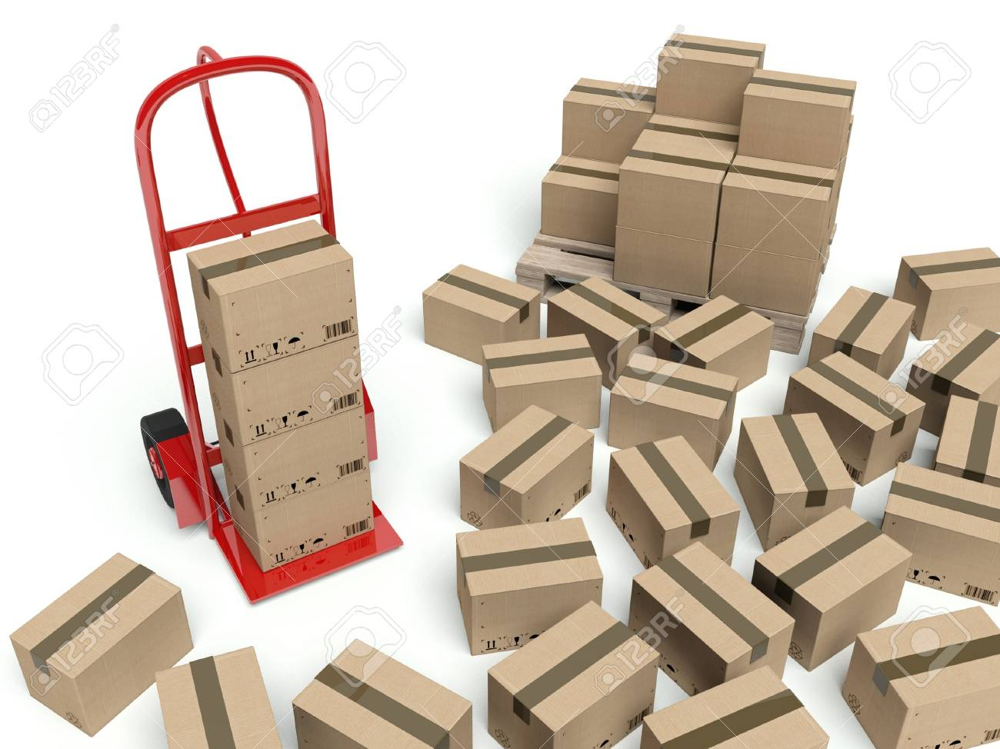

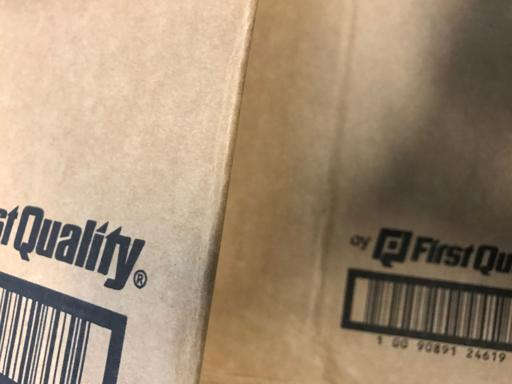

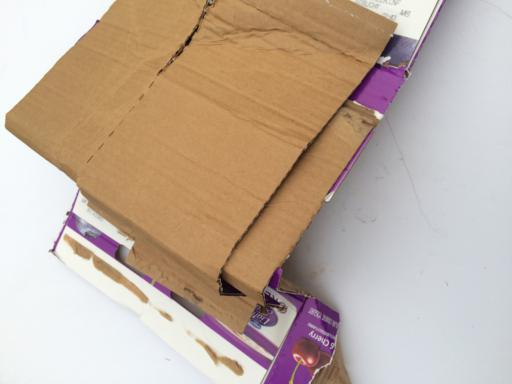

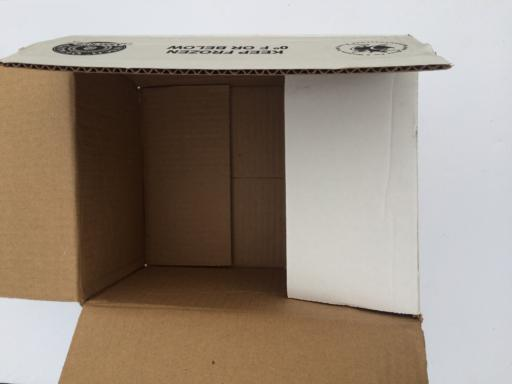

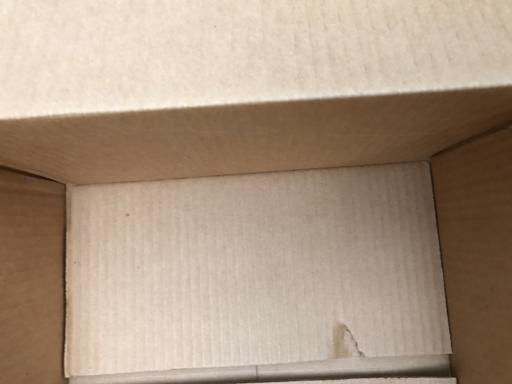

In [ ]:
#display 5 cardboard images

from IPython.display import Image
import random
from IPython.display import display

def displayImages(imageFolder):
  imageList = os.listdir('/tmp/data/train/'+imageFolder)
  a = Image('/tmp/data/train/'+str(imageFolder)+'/'+random.choice(imageList), width = 100, height = 100)
  b = Image('/tmp/data/train/'+str(imageFolder)+'/'+random.choice(imageList), width = 100, height = 100)
  c = Image('/tmp/data/train/'+str(imageFolder)+'/'+random.choice(imageList), width = 100, height = 100)
  d = Image('/tmp/data/train/'+str(imageFolder)+'/'+random.choice(imageList), width = 100, height = 100)
  e = Image('/tmp/data/train/'+str(imageFolder)+'/'+random.choice(imageList), width = 100, height = 100)
  display(a, b, c ,d, e)

displayImages('cardboard')

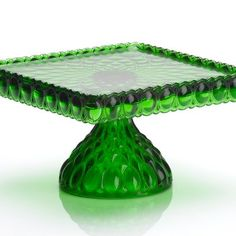

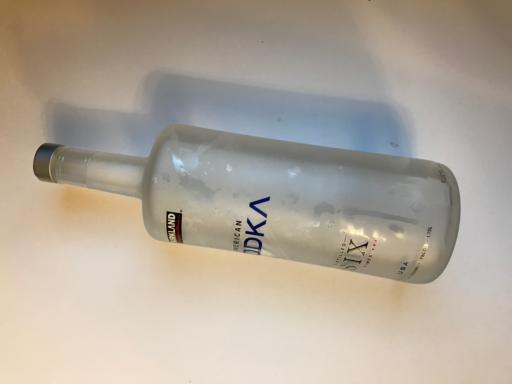

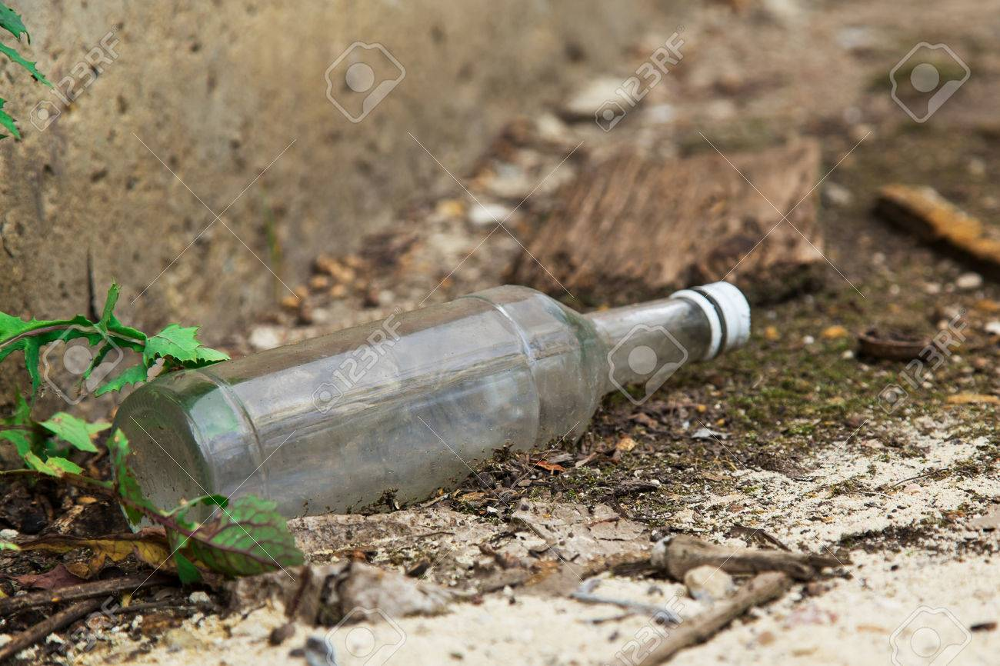

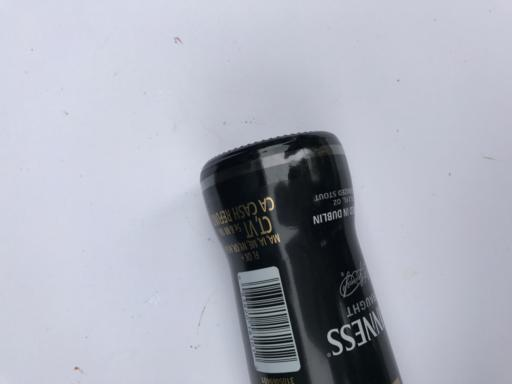

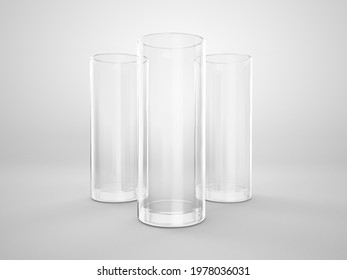

In [ ]:
#display glass images
displayImages('glass')

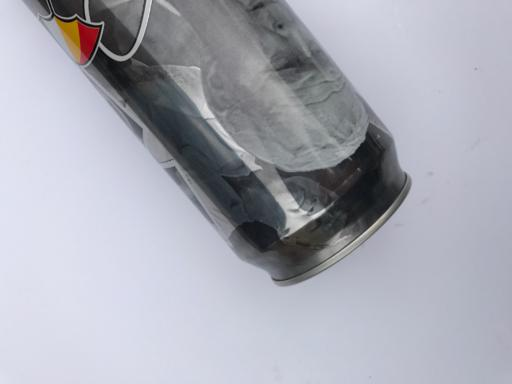

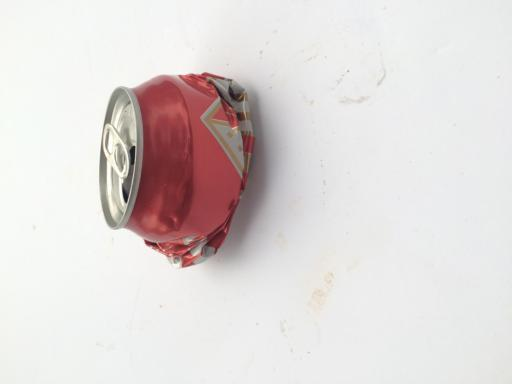

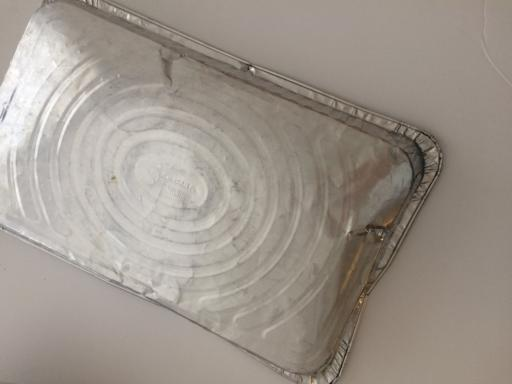

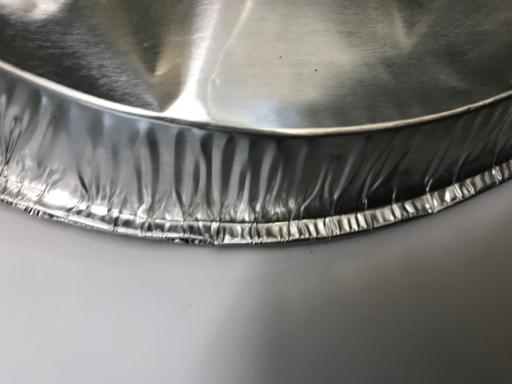

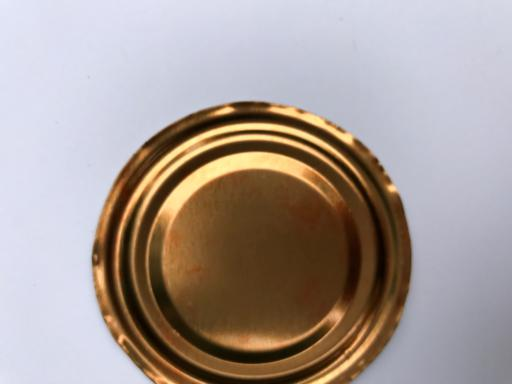

In [ ]:
#display metal images
displayImages('metal')

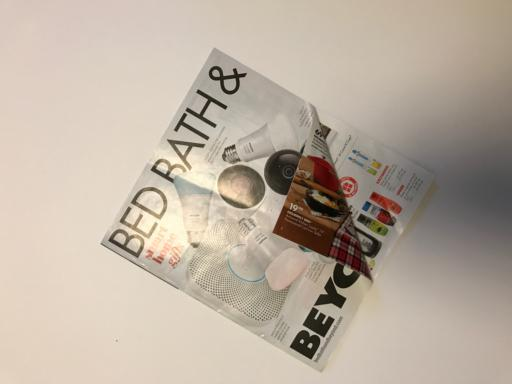

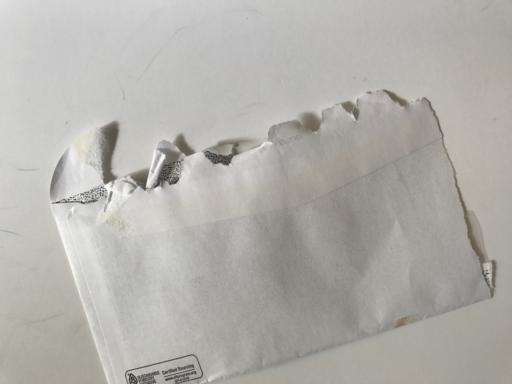

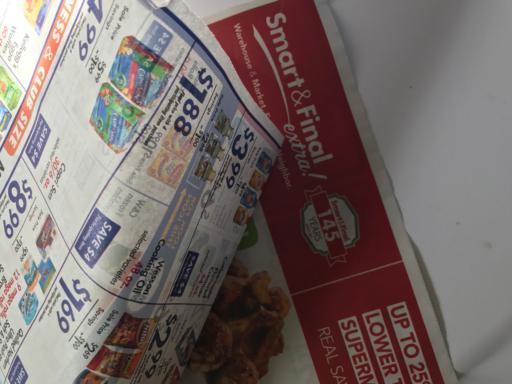

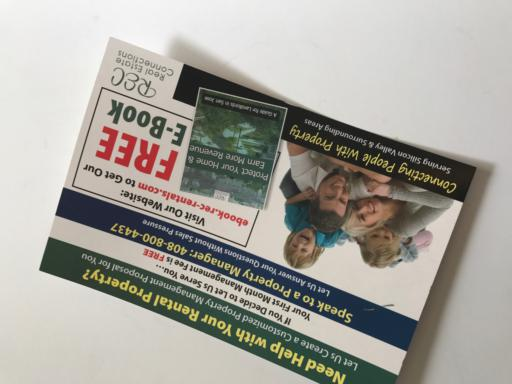

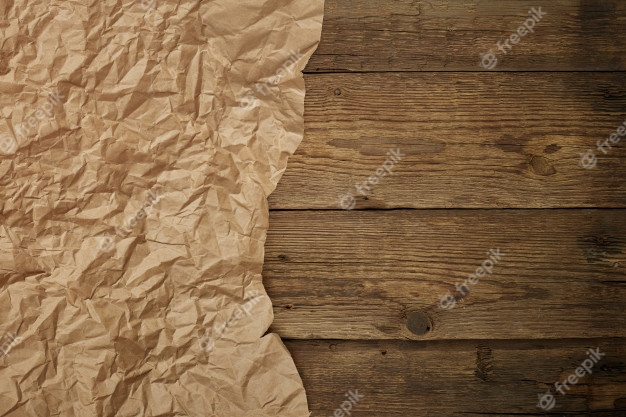

In [ ]:
#display paper images
displayImages('paper')

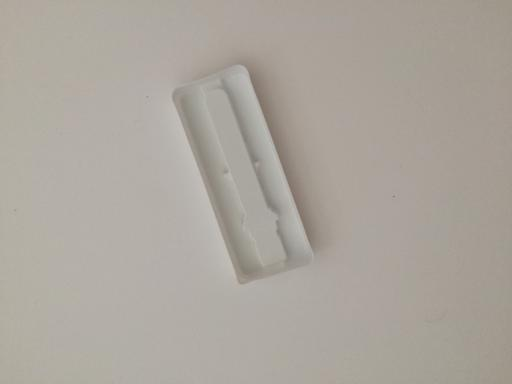

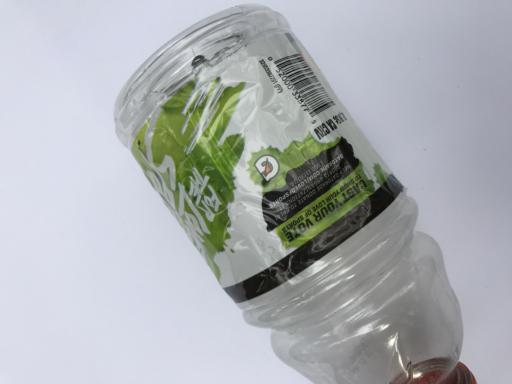

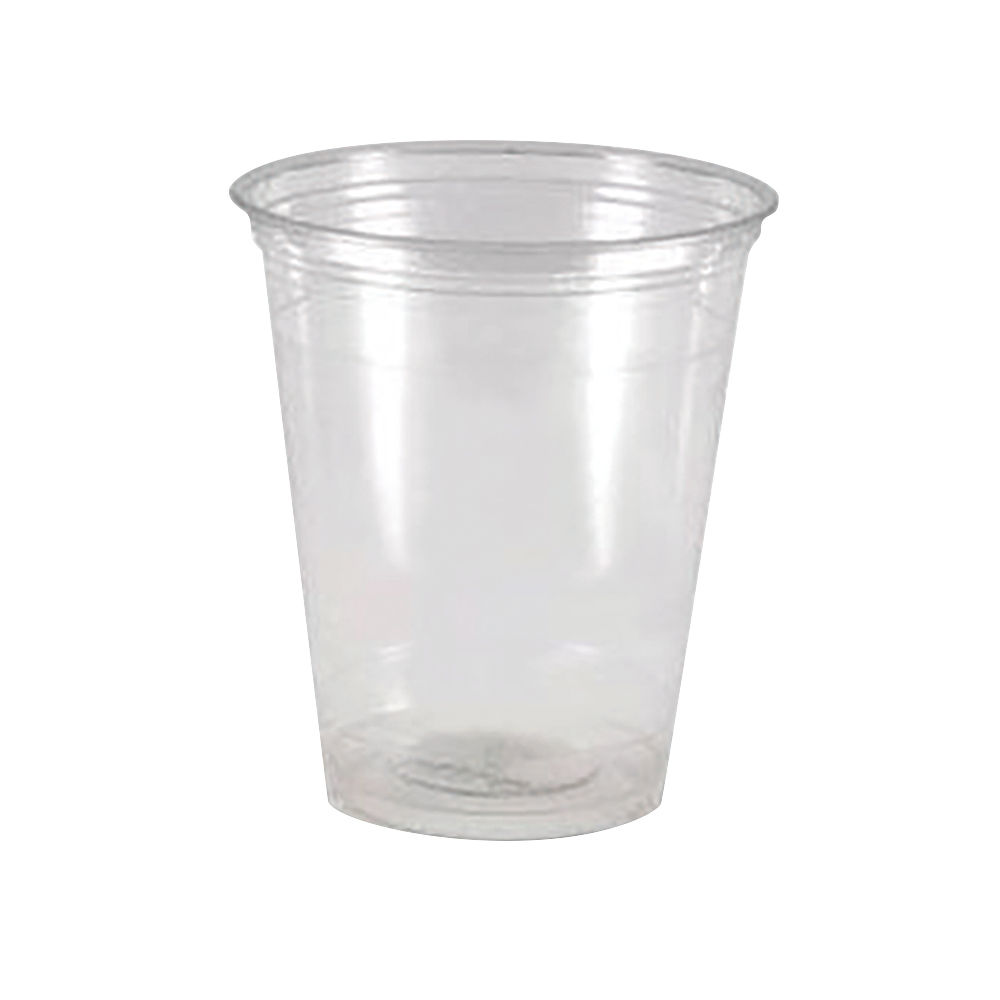

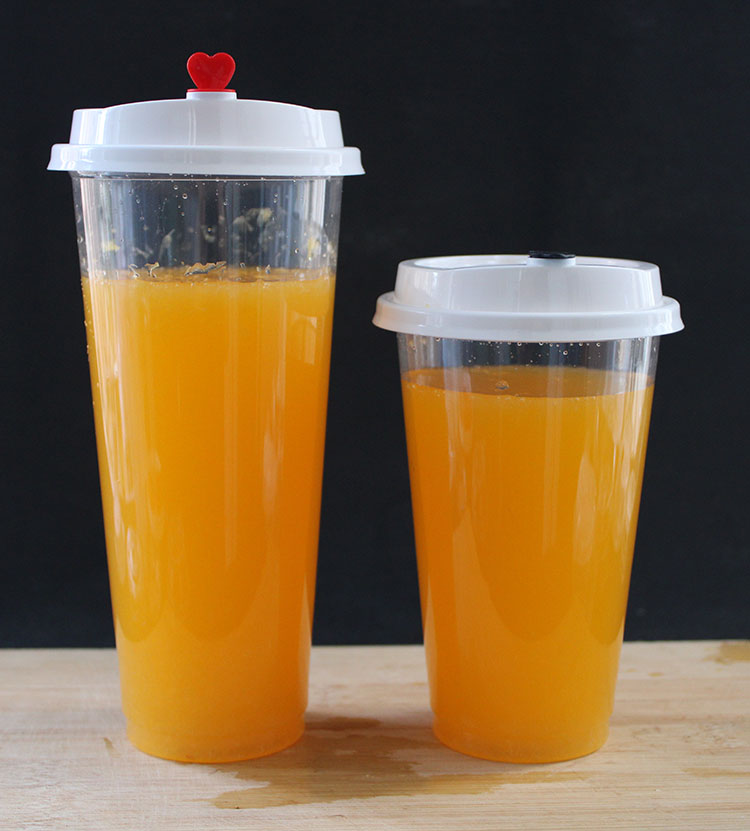

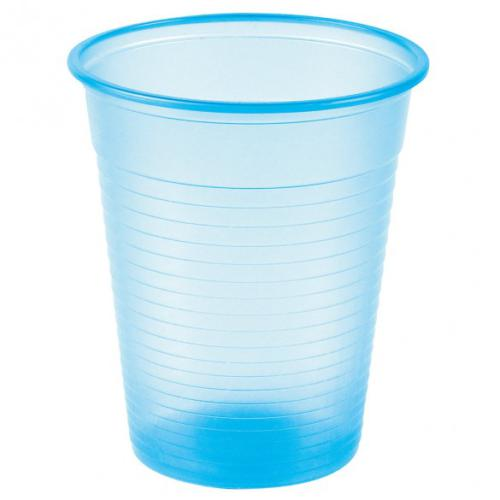

In [ ]:
#display plastic images
displayImages('plastic')

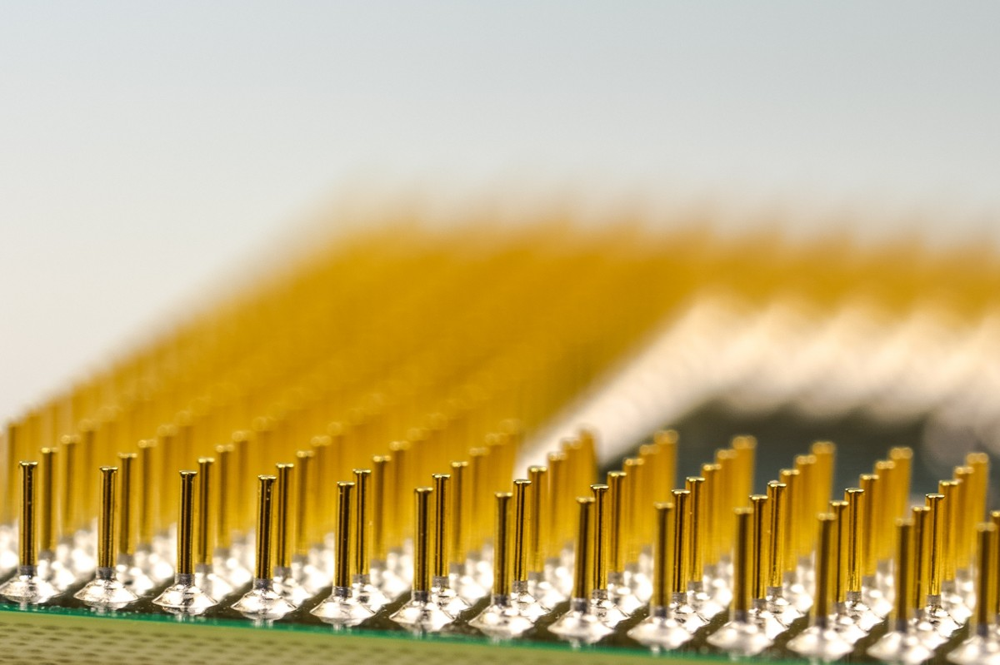

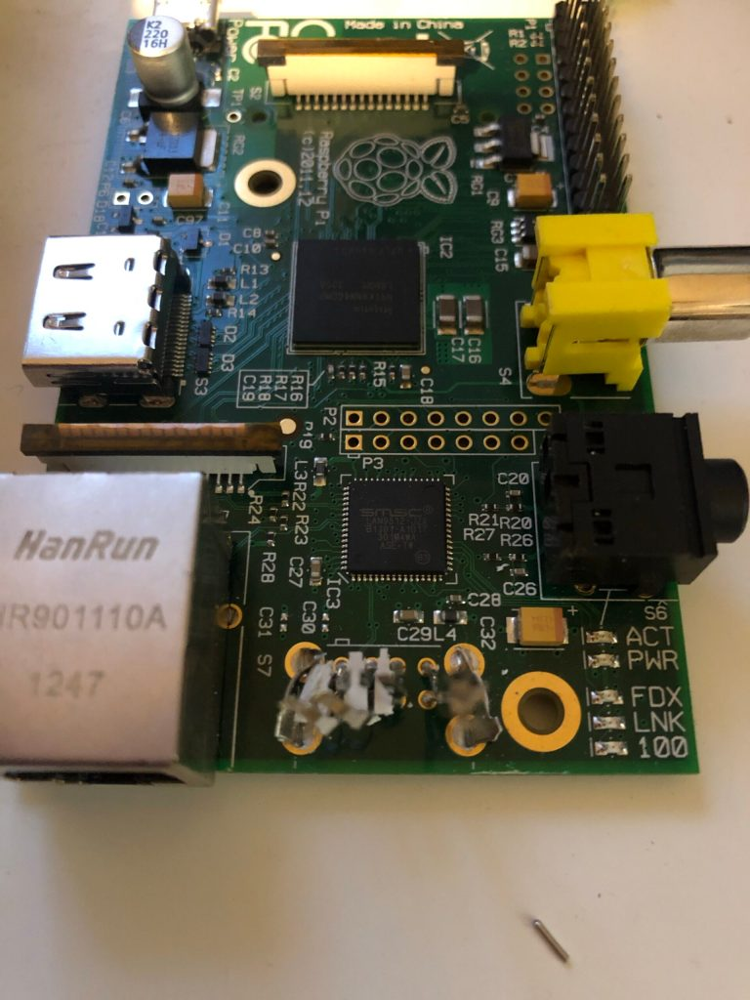

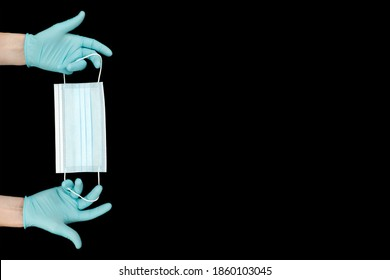

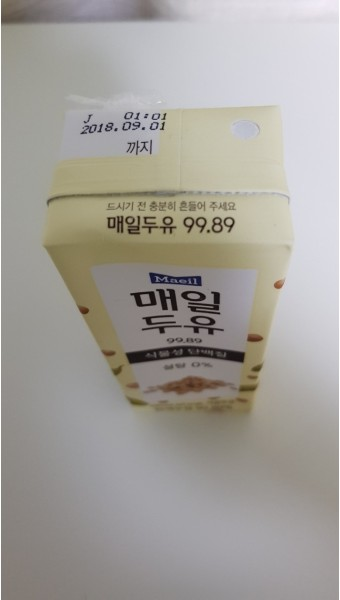

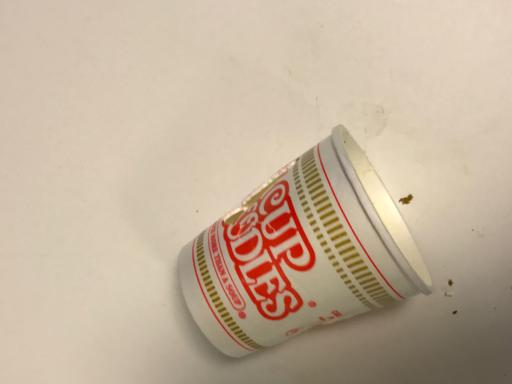

In [ ]:
#display trash images
displayImages('trash')

In [ ]:
#code to find corrupt images
#when initially training the model, the model training would be interrupted as 'paper 42.jpg' is an empty file
import PIL
from pathlib import Path
from PIL import UnidentifiedImageError

path = Path('/tmp/data/train/paper/').rglob('*.jpg')
for img_p in path:
    try:
        img = PIL.Image.open(img_p)
    except PIL.UnidentifiedImageError:
            print(img_p)

/tmp/data/train/paper/paper 42.jpg


In [ ]:
#/tmp/data/train/paper/paper 42.jpg found as corrupt
os.remove('/tmp/data/train/paper/paper 42.jpg')

In [ ]:
#test if image exists
#Image('/tmp/data/train/paper/paper 42.jpg', width = 100, height = 100)

In [ ]:
#creating training/validation/test data splits

import tensorflow as tf
from tensorflow import keras
import numpy as np
from keras_preprocessing.image import ImageDataGenerator

base_path_train = '/tmp/data/train'
base_path_test = '/tmp/data/test'

train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2
    )

test_datagen = ImageDataGenerator(
    rescale=1./255,
    )

IMAGE_SIZE = 150
TRAIN_BATCH_SIZE = 16

train_generator = train_datagen.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    seed=0,
    color_mode='rgb'
)

validation_generator = train_datagen.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='validation',
    seed=0,
    color_mode='rgb'
)

test_generator = test_datagen.flow_from_directory(
    base_path_test,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    seed=0,
    color_mode='rgb'
)

Found 3840 images belonging to 6 classes.
Found 957 images belonging to 6 classes.
Found 1198 images belonging to 6 classes.


In [ ]:
#create model
from tensorflow.keras import layers
from tensorflow.keras import models
from tensorflow.keras import optimizers

def make_model():
  model = models.Sequential()
  model.add(layers.Conv2D(32, (3, 3), activation='relu',
                          input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Dropout(0.2))
  model.add(layers.Conv2D(64, (3, 3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Dropout(0.2))
  model.add(layers.Conv2D(128, (3, 3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Dropout(0.2))
  model.add(layers.Flatten())
  model.add(layers.Dense(512, activation='relu'))
  model.add(layers.Dense(128, activation='relu'))
  model.add(layers.Dense(6, activation='softmax'))

  model.compile(loss='binary_crossentropy',
              optimizer=keras.optimizers.Adam(learning_rate=0.0001),
              metrics=['acc'])

  return model

model = make_model()  
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 74, 74, 32)       0         
 2D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 74, 74, 32)        0         
                                                                 
 conv2d_7 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 36, 36, 64)       0         
 2D)                                                             
                                                                 
 dropout_7 (Dropout)         (None, 36, 36, 64)       

In [ ]:
%%time
#train and save model
model = make_model()  

model.fit(train_generator, epochs=10, validation_data=validation_generator)

model.save('/tmp/recycledmodel')

Epoch 1/10
240/240 [==============================] - 149s 618ms/step - loss: 0.4330 - acc: 0.3151 - val_loss: 0.5012 - val_acc: 0.3532
Epoch 2/10
240/240 [==============================] - 143s 594ms/step - loss: 0.3909 - acc: 0.4206 - val_loss: 0.4679 - val_acc: 0.3333
Epoch 3/10
240/240 [==============================] - 144s 600ms/step - loss: 0.3654 - acc: 0.4708 - val_loss: 0.4527 - val_acc: 0.3908
Epoch 4/10
240/240 [==============================] - 144s 597ms/step - loss: 0.3484 - acc: 0.5060 - val_loss: 0.4361 - val_acc: 0.4044
Epoch 5/10
240/240 [==============================] - 142s 593ms/step - loss: 0.3313 - acc: 0.5411 - val_loss: 0.4304 - val_acc: 0.4138
Epoch 6/10
240/240 [==============================] - 144s 596ms/step - loss: 0.3123 - acc: 0.5719 - val_loss: 0.4185 - val_acc: 0.4222
Epoch 7/10
240/240 [==============================] - 142s 593ms/step - loss: 0.2933 - acc: 0.6112 - val_loss: 0.4265 - val_acc: 0.4138
Epoch 8/10
240/240 [============================

In [ ]:
#evaluate model
model.evaluate(test_generator)

45/75 [=================>............] - ETA: 7s - loss: 0.3554 - acc: 0.5250

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:770: UserWarning: Possibly corrupt EXIF data.  Expecting to read 11 bytes but only got 10. Skipping tag 42037
  " Skipping tag %s" % (size, len(data), tag)


49/75 [==================>...........] - ETA: 6s - loss: 0.3557 - acc: 0.5242

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


75/75 [==============================] - 18s 236ms/step - loss: 0.3484 - acc: 0.5434


[0.3483961820602417, 0.5434056520462036]

In [ ]:
#save model
model.save('/tmp/recycledmodel.h5')

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#copy model to drive for later use
shutil.copy('/tmp/recycledmodel.h5','/content/gdrive/MyDrive/recycledmodel.h5')

'/content/gdrive/MyDrive/recycledmodel.h5'

In [ ]:
#import model
model = tf.keras.models.load_model('/content/gdrive/MyDrive/recycledmodel.h5')

## **Task 2 (C Task) Analyse and improve the model**

### Task 2.1 Build an input pipeline for data augmentation


Build a data preprocessing pipeline to perform data augmentation. (You may use Keras ImageDataGenerator or write your own transformations.)

- Report the model performance with the pipeline added. How much performance gain have you achieved?    

- Profile your input pipeline to identify the most time-consuming operation. What actions have you taken to address that slow operation? (*Hint: You may use a profiler such as the [TensorFlow Profiler](https://github.com/tensorflow/profiler).*)


### Task 2.2 Compare the performance under equal training time

You may notice that with your pipeline, the model performance improves, but at the cost of a longer training time per epoch. Is the additional training time well spent? Compare the dynamic of model performance (e.g., classification accuracy on the test data) with and without data augmentation, when equal training time is spent in the two scenarios. 

### Task 2.3 Identifying model strength and weakness

Identify images that are incorrectly classified by your model. Do they share something in common? How do you plan to improve the model's performance on those images? 

Found 3688 images belonging to 6 classes.
{'cardboard': 0, 'glass': 1, 'metal': 2, 'paper': 3, 'plastic': 4, 'trash': 5}
Found 4608 images belonging to 6 classes.


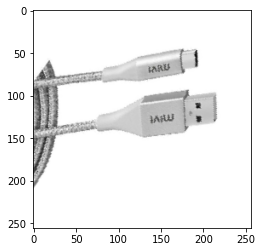

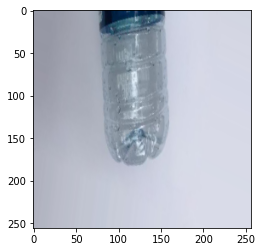

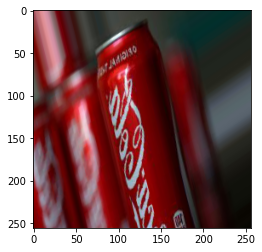

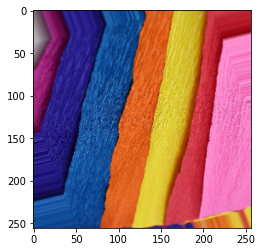

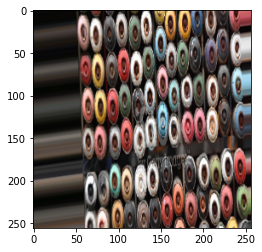

In [ ]:
#task 2.1 & 2.2

#creating augmentation pipeline and showing resulting images

import matplotlib.pyplot as plt

def image_augmentation(img):
  def contrast(img):
    return tf.image.random_contrast(img, 0.7, 2)
  def hue(img):
    return tf.image.random_hue(img, 0.4)
  def saturation(img):
    return tf.image.random_saturation(img, 0.4, 3)
  aug_img = contrast(img)
  aug_img = hue(aug_img)
  aug_img = saturation(aug_img)
  return np.array(aug_img)

augment_datagen = ImageDataGenerator(
      rotation_range=30,
      horizontal_flip=True,
      vertical_flip=True,
      height_shift_range=0.2,
      width_shift_range=0.2,
      rescale=1./255,
      validation_split=0.2,
      zoom_range=0.35,
      shear_range=25
      #preprocessing_function= image_augmentation
)

augment_generator = augment_datagen.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    seed=50,
    color_mode='rgb'
)

print(augment_generator.class_indices)


image_generator = augment_datagen.flow_from_directory(
    base_path_train,
    batch_size=1,
    save_to_dir="/tmp",
    save_prefix="testimage",
    save_format='png',
    seed = 50
)

for _ in range(5):
    img, label = image_generator.next()
    plt.imshow(img[0])
    plt.show()

Found 4608 images belonging to 6 classes.


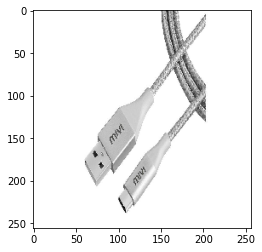

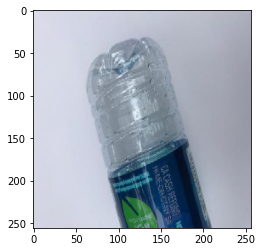

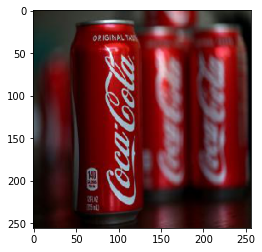

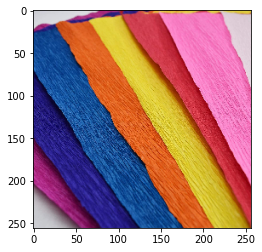

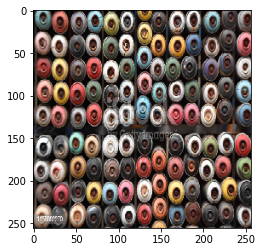

In [ ]:
#showing the original images
image_generator = train_datagen.flow_from_directory(
    base_path_train,
    batch_size=1,
    save_to_dir="/tmp",
    save_prefix="testimage",
    save_format='png',
    seed = 50
)

for _ in range(5):
    img, label = image_generator.next()
    plt.imshow(img[0])
    plt.show()

In [ ]:
#setting up tensorboard profiler

from datetime import datetime
from packaging import version

!pip install -U tensorboard_plugin_profile

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Create a TensorBoard callback
logs = "logs/" + datetime.now().strftime("%Y%m%d-%H%M%S")

tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logs,
                                                 histogram_freq = 1,
                                                 profile_batch = '1,40')

In [ ]:
model.fit(augment_generator, epochs=10, validation_data=validation_generator, callbacks = [tboard_callback])

Epoch 1/10
 62/240 [======>.......................] - ETA: 1:42 - loss: 0.3845 - acc: 0.4446

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


240/240 [==============================] - ETA: 0s - loss: 0.3651 - acc: 0.4745

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:770: UserWarning: Possibly corrupt EXIF data.  Expecting to read 11 bytes but only got 10. Skipping tag 42037
  " Skipping tag %s" % (size, len(data), tag)


240/240 [==============================] - 158s 654ms/step - loss: 0.3651 - acc: 0.4745 - val_loss: 0.4117 - val_acc: 0.4148
Epoch 2/10
240/240 [==============================] - 156s 650ms/step - loss: 0.3477 - acc: 0.5021 - val_loss: 0.3982 - val_acc: 0.4441
Epoch 3/10
240/240 [==============================] - 155s 647ms/step - loss: 0.3378 - acc: 0.5271 - val_loss: 0.3941 - val_acc: 0.4504
Epoch 4/10
240/240 [==============================] - 160s 667ms/step - loss: 0.3300 - acc: 0.5391 - val_loss: 0.3887 - val_acc: 0.4525
Epoch 5/10
240/240 [==============================] - 154s 640ms/step - loss: 0.3270 - acc: 0.5474 - val_loss: 0.3894 - val_acc: 0.4462
Epoch 6/10
240/240 [==============================] - 157s 655ms/step - loss: 0.3214 - acc: 0.5544 - val_loss: 0.3990 - val_acc: 0.4190
Epoch 7/10
240/240 [==============================] - 154s 642ms/step - loss: 0.3202 - acc: 0.5549 - val_loss: 0.3833 - val_acc: 0.4347
Epoch 8/10
240/240 [==============================] - 154s 

In [ ]:
model.evaluate(test_generator)

75/75 [==============================] - 17s 226ms/step - loss: 0.3146 - acc: 0.6010


[0.3146249055862427, 0.6010016798973083]

In [ ]:
#save model
model.save('/tmp/augmentmodel.h5')
shutil.copy('/tmp/augmentmodel.h5','/content/gdrive/MyDrive/augmentmodel.h5')

'/content/gdrive/MyDrive/augmentmodel.h5'

In [ ]:
# Load the TensorBoard notebook extension.
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
# Launch TensorBoard and navigate to the Profile tab to view performance profile
%tensorboard --logdir=logs

Reusing TensorBoard on port 6006 (pid 863), started 0:39:08 ago. (Use '!kill 863' to kill it.)

<IPython.core.display.Javascript object>

{0: 'cardboard', 1: 'glass', 2: 'metal', 3: 'paper', 4: 'plastic', 5: 'trash'}


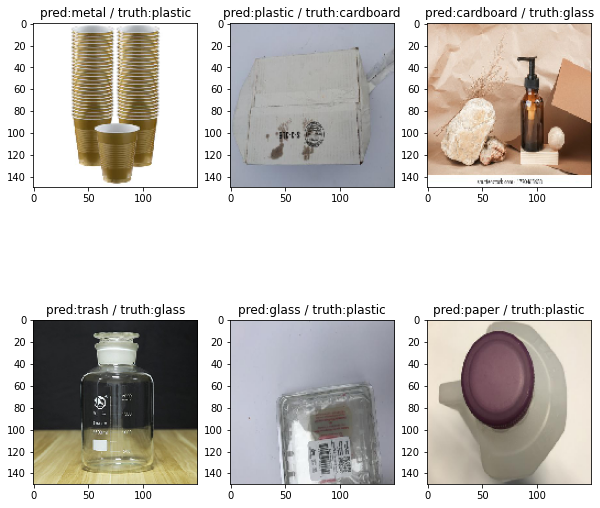

In [ ]:
#task 2.3

from IPython.display import Image
import random
from IPython.display import display

test_x, test_y = test_generator.__getitem__(1)

labels = (train_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())

print(labels)

preds = model.predict(test_x)

incorrect_found = []

for i in range(16):
    if(labels[np.argmax(preds[i])] != labels[np.argmax(test_y[i])]):
      incorrect_found.append(i)

test_x_found = []
for i in range(6):
  test_x_found.append(test_x[incorrect_found[i]])


incorrect_found = incorrect_found[0:6]

plt.figure(figsize=(10, 10))
s = 0
for i in incorrect_found:
  plt.subplot(2, 3, s+1)
  plt.title('pred:%s / truth:%s' % (labels[np.argmax(preds[i])], labels[np.argmax(test_y[i])]))
  plt.imshow(test_x_found[s])
  s += 1

## **Task 2 (C Task) Response**

### Task 2.1 Build an input pipeline for data augmentation

- Report the model performance with the pipeline added. How much performance gain have you achieved?

***Response:*** The initial model without data augmentation resulted in a 54.3% accuracy on the testing dataset. The data augmentation pipeline trained into the base model increased the performance to 60% accuracy on the testing dataset.

- Profile your input pipeline to identify the most time-consuming operation.


### Task 2.2 Compare the performance under equal training time

You may notice that with your pipeline, the model performance improves, but at the cost of a longer training time per epoch. Is the additional training time well spent? Compare the dynamic of model performance (e.g., classification accuracy on the test data) with and without data augmentation, when equal training time is spent in the two scenarios. 

***Response:*** The extra training time I believe is time well spent. Even though the training time is significant, a 6% increase in performance is a worthy trade off. For context, my test dataset is around 1200 images. Accuracy of 54% is around 650 correctly identified images, accuracy of 60% is 720 correctly identified images which is a significant boost.


### Task 2.3 Identifying model strength and weakness

Identify images that are incorrectly classified by your model. Do they share something in common? How do you plan to improve the model's performance on those images?

***Response:*** The incorrectly classified images seem to have the common issue of not being able to interpret colour correctly. The first image I can assume it incorrectly predicted due to the colour gold being common with metals. Images 4 & 5 reflect that the model is having trouble with transparent items as glass, plastic and trash can all have transparent properties. The same can be inferred from images 2 & 6. The white/cream/beige tones can all be found in plastic, paper and cardboard which is confusing the model.

I plan to improve the model by trying to augment the data to use grayscale images to avoid issues with colour in classification.

## **Task 3 (D Task) Improve model generalisability across domains**

So far, you have used training and test images from the same source (via random data split). Now collect new test images from a different source. For example, you may take some photos yourself if you used downloaded images before.
Otherwise, you may take new photos using a different mobile phone or against a different background.

Show sample images from the original test data and the newly collected test data. In what ways are they different?

Feed the new test data into your model. Report the performance change.

Improve your model so that it generalises better on unseen test images.


###**Task 3 Response:**###

As I had downloaded my initial dataset, my plan for newly introduced data is to use images taken via mobile phone on a white background. My photos are fairly similar to the initial dataset though instead of a plain white background, mine includes some distortion from ruffles in the background. Many of my original dataset is also stock photos from Google which differ greatly from my self taken images.

After feeding the new data into the model, I was unable to have the updated model increase accuracy on the test dataset. This is very likely due to the difference in the new images from the testing dataset and the change of weights negatively effecting the model evaluation. Another cause is the newly introduced dataset is too small to have enough examples of all categories to assist the model positively.

####**Improving Model Accuracy:**

I've attempted adding layers to my model to increase performance which resulted in negatively effecting the accuracy. I have attempted grayscale augmentation which has slightly altered performance negatively on unseen data.

Another attempt at boosting accuracy was cleaning the dataset for images I considered low quality and not completing matching the description of the classes. I used the same untrained initial model I have created and trained with the clean dataset. This resulted in a minor decrease in accuracy.

Considering these trails, I am unable to create an accuracy increase from my initial data augmentation in Task 2.


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#training my images in to model

#creating training/validation/test data splits

import tensorflow as tf
from tensorflow import keras
import numpy as np
from keras_preprocessing.image import ImageDataGenerator

base_path_train = '/content/gdrive/MyDrive/recycle_images'

train_datagen_2 = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2
    )

IMAGE_SIZE = 150
TRAIN_BATCH_SIZE = 8

train_generator_2 = train_datagen_2.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    seed=0,
    color_mode='rgb'
)

validation_generator_2 = train_datagen_2.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='validation',
    seed=0,
    color_mode='rgb'
)

Found 90 images belonging to 6 classes.
Found 19 images belonging to 6 classes.


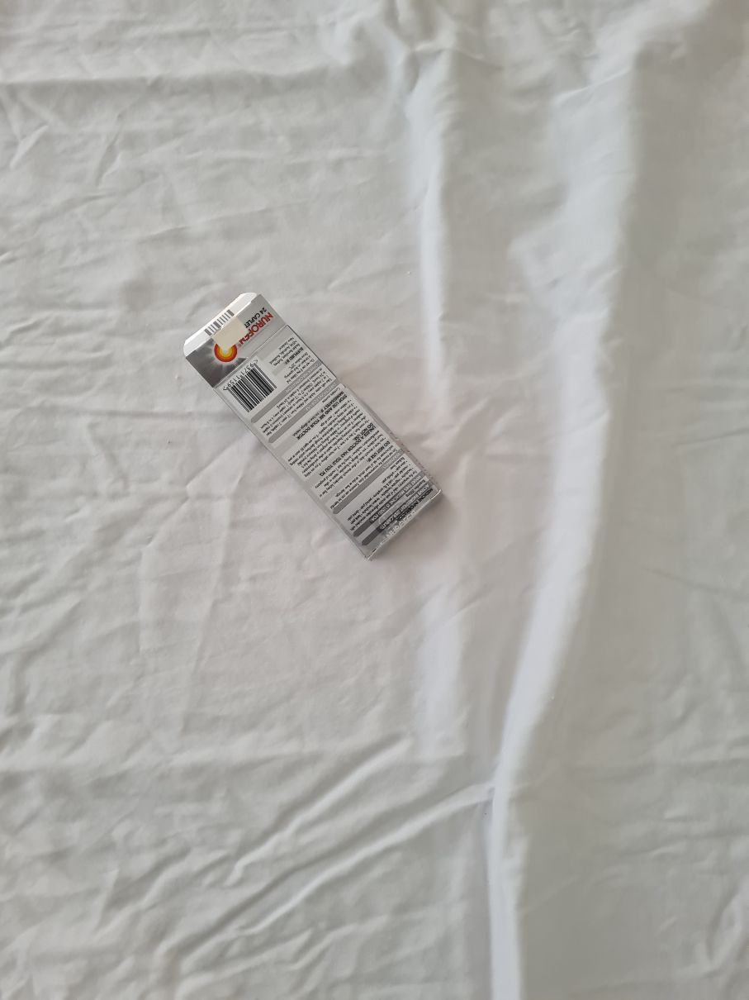

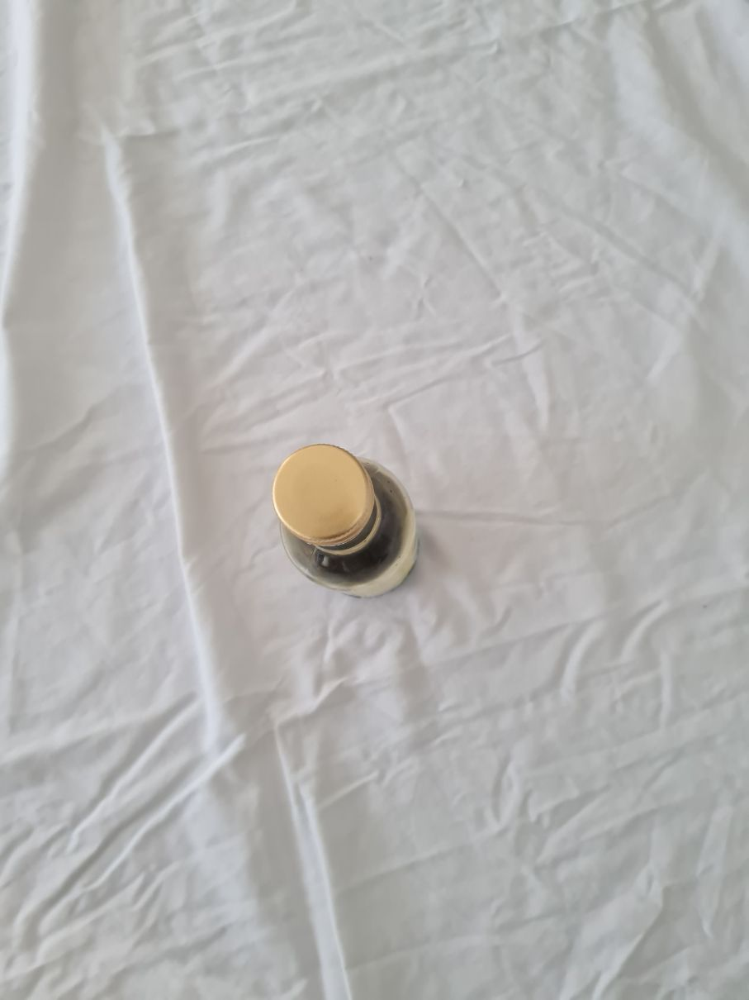

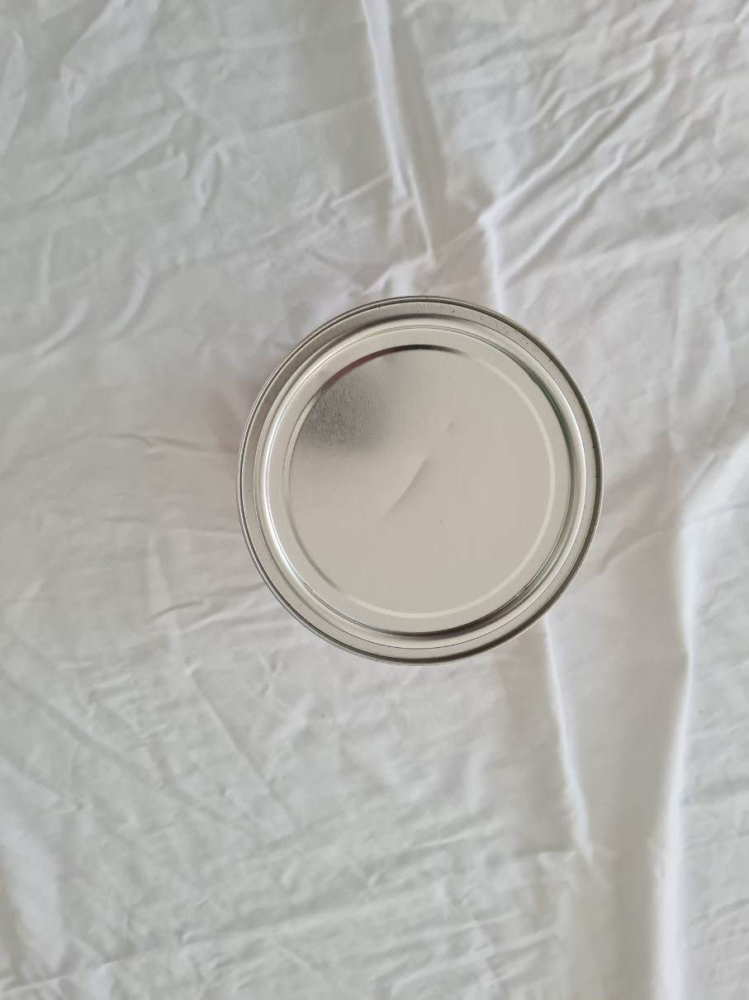

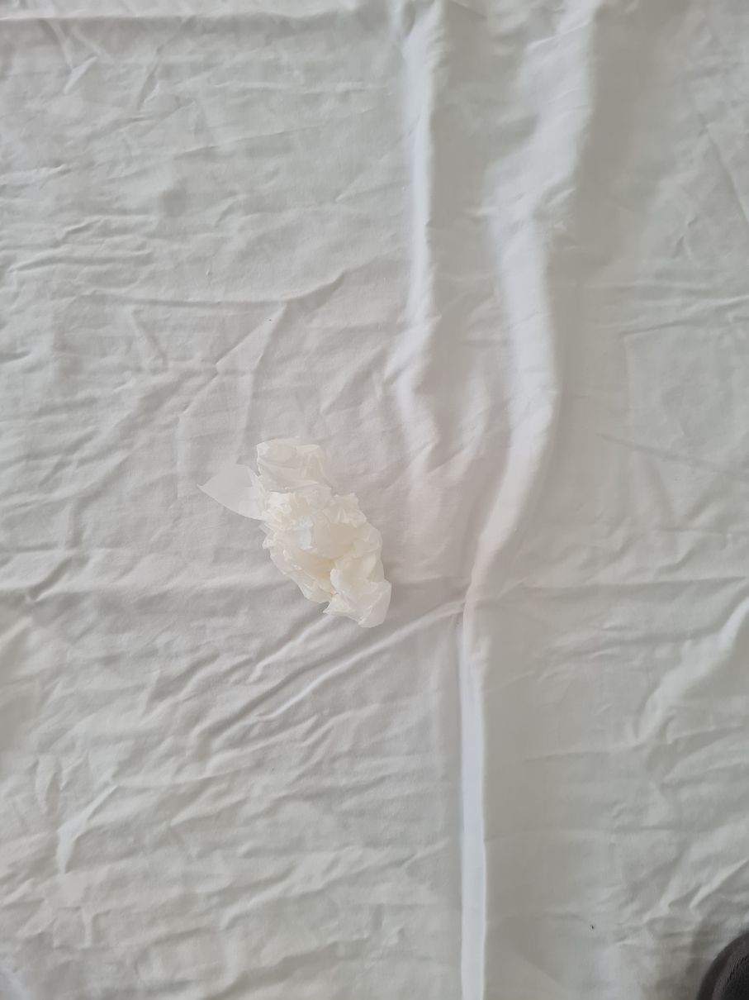

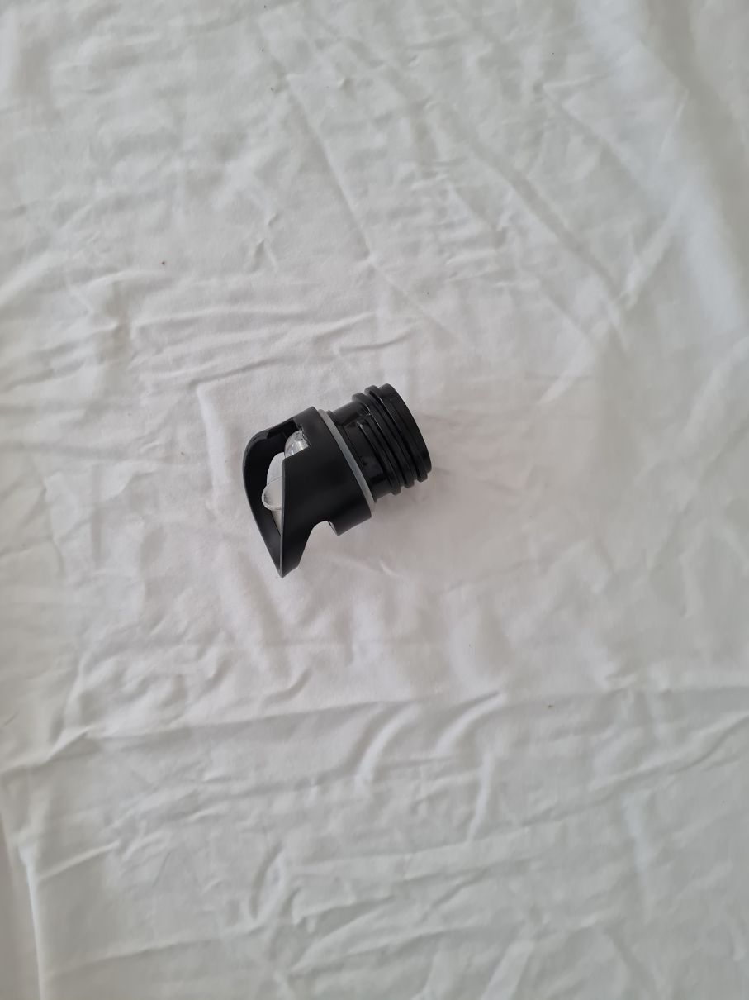

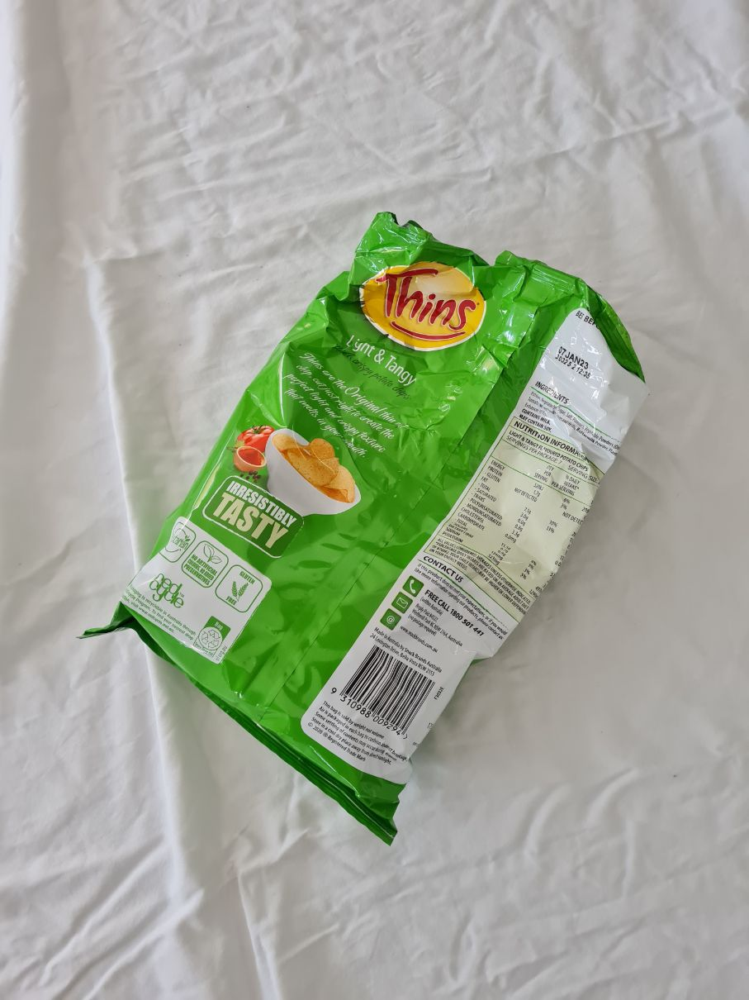

In [ ]:
#images from new dataset
from IPython.display import Image
import random
from IPython.display import display

imageList = os.listdir('/content/gdrive/MyDrive/recycle_images/cardboard')
a = Image('/content/gdrive/MyDrive/recycle_images/cardboard'+'/'+random.choice(imageList), width = 100, height = 100)
imageList = os.listdir('/content/gdrive/MyDrive/recycle_images/glass')
b = Image('/content/gdrive/MyDrive/recycle_images/glass'+'/'+random.choice(imageList), width = 100, height = 100)
imageList = os.listdir('/content/gdrive/MyDrive/recycle_images/metal')
c = Image('/content/gdrive/MyDrive/recycle_images/metal'+'/'+random.choice(imageList), width = 100, height = 100)
imageList = os.listdir('/content/gdrive/MyDrive/recycle_images/paper')
d = Image('/content/gdrive/MyDrive/recycle_images/paper'+'/'+random.choice(imageList), width = 100, height = 100)
imageList = os.listdir('/content/gdrive/MyDrive/recycle_images/plastic')
e = Image('/content/gdrive/MyDrive/recycle_images/plastic'+'/'+random.choice(imageList), width = 100, height = 100)
imageList = os.listdir('/content/gdrive/MyDrive/recycle_images/trash')
f = Image('/content/gdrive/MyDrive/recycle_images/trash'+'/'+random.choice(imageList), width = 100, height = 100)
display(a, b, c ,d, e, f)

In [ ]:
model = tf.keras.models.load_model('/content/gdrive/MyDrive/augmentmodel.h5')

In [ ]:
model.fit(train_generator_2, epochs=2, validation_data=validation_generator_2)

Epoch 1/2
12/12 [==============================] - 5s 376ms/step - loss: 0.4368 - acc: 0.3222 - val_loss: 0.3611 - val_acc: 0.5789
Epoch 2/2
12/12 [==============================] - 4s 353ms/step - loss: 0.3686 - acc: 0.4222 - val_loss: 0.3935 - val_acc: 0.4211


In [ ]:
model.evaluate(test_generator)

75/75 [==============================] - 15s 200ms/step - loss: 0.3633 - acc: 0.4875


[0.3633275330066681, 0.4874791204929352]

In [ ]:
model = tf.keras.models.load_model('/content/gdrive/MyDrive/augmentmodel.h5')

Found 3840 images belonging to 6 classes.
Found 4797 images belonging to 6 classes.


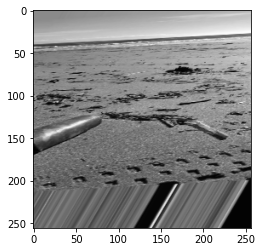

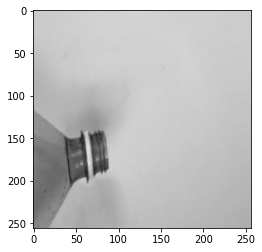

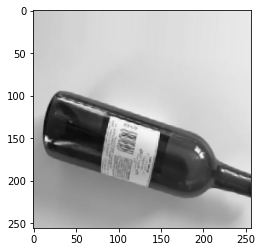

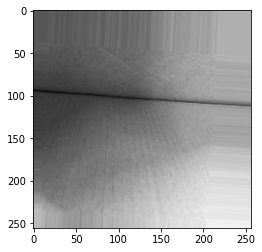

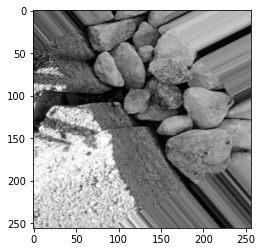

In [ ]:
#attempting grayscale on dataset to increase accuracy of model

import matplotlib.pyplot as plt

def image_augmentation(img):
  def grayscale(img):
    return tf.image.rgb_to_grayscale(img)
  aug_img = grayscale(img)
  return np.array(aug_img)

base_path_train = '/tmp/data/train'

TRAIN_BATCH_SIZE = 32

augment_datagen_2 = ImageDataGenerator(
      rescale=1./255,
      preprocessing_function= image_augmentation,
      validation_split= 0.2,
      rotation_range=30,
      horizontal_flip=True,
      vertical_flip=True,
      height_shift_range=0.2,
      width_shift_range=0.2,
      zoom_range=0.35,
      shear_range=25
)

augment_generator_2 = augment_datagen_2.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    seed=0,
)

image_generator = augment_datagen_2.flow_from_directory(
    base_path_train,
    batch_size=1,
    save_to_dir="/tmp",
    save_prefix="testimage",
    save_format='png',
    seed = 0
)

for _ in range(5):
    img, label = image_generator.next()
    plt.imshow(img[0])
    plt.show()

In [ ]:
model.fit(augment_generator_2, epochs=10, validation_data=validation_generator)

Epoch 1/10
120/120 [==============================] - 152s 1s/step - loss: 0.3944 - acc: 0.4042 - val_loss: 0.3963 - val_acc: 0.4159
Epoch 2/10
120/120 [==============================] - 153s 1s/step - loss: 0.3833 - acc: 0.4391 - val_loss: 0.3989 - val_acc: 0.4033
Epoch 3/10
120/120 [==============================] - 152s 1s/step - loss: 0.3779 - acc: 0.4492 - val_loss: 0.4074 - val_acc: 0.3845
Epoch 4/10
120/120 [==============================] - 154s 1s/step - loss: 0.3732 - acc: 0.4570 - val_loss: 0.4093 - val_acc: 0.3793
Epoch 5/10
120/120 [==============================] - 154s 1s/step - loss: 0.3706 - acc: 0.4656 - val_loss: 0.4020 - val_acc: 0.3887
Epoch 6/10
120/120 [==============================] - 153s 1s/step - loss: 0.3691 - acc: 0.4690 - val_loss: 0.4028 - val_acc: 0.4023
Epoch 7/10
120/120 [==============================] - 155s 1s/step - loss: 0.3675 - acc: 0.4719 - val_loss: 0.4037 - val_acc: 0.3772
Epoch 8/10
120/120 [==============================] - 152s 1s/step - 

In [ ]:
model.evaluate(test_generator)

75/75 [==============================] - 16s 211ms/step - loss: 0.3571 - acc: 0.5184


[0.357085257768631, 0.5183639526367188]

In [ ]:
#attempting cleaning the dataset of questionable quality images to attempt to increase accuracy

with open('/content/gdrive/MyDrive/remove lists/remove_cardboard.txt') as f:
    lines = [line.rstrip() for line in f]
print('cardboard in dataset' , len(os.listdir('/tmp/dataset-resized/cardboard')))
for i in lines:
  os.remove('/tmp/dataset-resized/cardboard/'+ i + '.jpg')

print('cardboard in dataset' , len(os.listdir('/tmp/dataset-resized/cardboard')))

cardboard in dataset 886
cardboard in dataset 764


In [ ]:
with open('/content/gdrive/MyDrive/remove lists/remove_glass.txt') as f:
    lines = [line.rstrip() for line in f]
print('glass in dataset' , len(os.listdir('/tmp/dataset-resized/glass')))
for i in lines:
  os.remove('/tmp/dataset-resized/glass/'+ i + '.jpg')

print('glass in dataset' , len(os.listdir('/tmp/dataset-resized/glass')))

glass in dataset 1007
glass in dataset 949


In [ ]:
with open('/content/gdrive/MyDrive/remove lists/remove_metal.txt') as f:
    lines = [line.rstrip() for line in f]
print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))
for i in lines:
  os.remove('/tmp/dataset-resized/metal/'+ i + '.jpg')

print('metal in dataset' , len(os.listdir('/tmp/dataset-resized/metal')))

metal in dataset 820
metal in dataset 815


In [ ]:
with open('/content/gdrive/MyDrive/remove lists/remove_paper.txt') as f:
    lines = [line.rstrip() for line in f]
print('paper in dataset' , len(os.listdir('/tmp/dataset-resized/paper')))
for i in lines:
  os.remove('/tmp/dataset-resized/paper/'+ i + '.jpg')

print('paper in dataset' , len(os.listdir('/tmp/dataset-resized/paper')))

paper in dataset 847
paper in dataset 839


In [ ]:
with open('/content/gdrive/MyDrive/remove lists/remove_plastic.txt') as f:
    lines = [line.rstrip() for line in f]
print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))
for i in lines:
  os.remove('/tmp/dataset-resized/plastic/'+ i + '.jpg')

print('plastic in dataset' , len(os.listdir('/tmp/dataset-resized/plastic')))

plastic in dataset 815
plastic in dataset 768


In [ ]:
#create folders to split data into training and testing sets

import shutil

classes = ('cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash')
# create sub-folders for each class
output_path = '/tmp/data-cleaned'
input_path = '/tmp/dataset-resized'

for i in classes:
  train_path = output_path + '/train/' + i + '/'
  test_path  = output_path + '/test/' + i + '/'

  in_path    = input_path + '/' + i + '/'

  os.makedirs(train_path , exist_ok=True)
  os.makedirs(test_path, exist_ok=True)

  filenames = os.listdir(in_path)

  no_of_pictures = len(filenames)

  test_set = int(len(filenames) * 0.2)
  train_set= len(filenames) - test_set

  test_imgs = filenames[:test_set]
  train_imgs = filenames[test_set:]

  for test_img in test_imgs:
    shutil.move(in_path + test_img, test_path + test_img)
  for train_img in train_imgs:
    shutil.move(in_path + train_img, train_path + train_img)

In [ ]:
#creating training/validation/test data splits

import tensorflow as tf
from tensorflow import keras
import numpy as np
from keras_preprocessing.image import ImageDataGenerator

base_path_train = '/tmp/data-cleaned/train'
base_path_test = '/tmp/data-cleaned/test'

train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2
    )

test_datagen = ImageDataGenerator(
    rescale=1./255,
    )

IMAGE_SIZE = 150
TRAIN_BATCH_SIZE = 16

train_generator = train_datagen.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    seed=0,
    color_mode='rgb'
)

validation_generator = train_datagen.flow_from_directory(
    base_path_train,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='validation',
    seed=0,
    color_mode='rgb'
)

test_generator = test_datagen.flow_from_directory(
    base_path_test,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=TRAIN_BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    seed=0,
    color_mode='rgb'
)

Found 3688 images belonging to 6 classes.
Found 920 images belonging to 6 classes.
Found 1148 images belonging to 6 classes.


In [ ]:
from tensorflow.keras import layers
from tensorflow.keras import models
from tensorflow.keras import optimizers

def make_model():
  model = models.Sequential()
  model.add(layers.Conv2D(32, (3, 3), activation='relu',
                          input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Dropout(0.2))
  model.add(layers.Conv2D(64, (3, 3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Dropout(0.2))
  model.add(layers.Conv2D(128, (3, 3), activation='relu'))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Dropout(0.2))
  model.add(layers.Flatten())
  model.add(layers.Dense(512, activation='relu'))
  model.add(layers.Dense(128, activation='relu'))
  model.add(layers.Dense(6, activation='softmax'))

  model.compile(loss='binary_crossentropy',
              optimizer=keras.optimizers.Adam(learning_rate=0.0001),
              metrics=['acc'])

  return model

model = make_model()  
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 32)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 74, 74, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 64)       0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 36, 36, 64)        0

In [ ]:
%%time

model = make_model()  

model.fit(train_generator, epochs=10, validation_data=validation_generator)

model.save('/tmp/recycledmodel-clean')

Epoch 1/10
 68/231 [=======>......................] - ETA: 1:25 - loss: 0.4624 - acc: 0.2500

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


231/231 [==============================] - ETA: 0s - loss: 0.4357 - acc: 0.3080

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:770: UserWarning: Possibly corrupt EXIF data.  Expecting to read 11 bytes but only got 10. Skipping tag 42037
  " Skipping tag %s" % (size, len(data), tag)


231/231 [==============================] - 138s 593ms/step - loss: 0.4357 - acc: 0.3080 - val_loss: 0.5110 - val_acc: 0.3609
Epoch 2/10
231/231 [==============================] - 136s 588ms/step - loss: 0.3959 - acc: 0.3956 - val_loss: 0.4806 - val_acc: 0.3696
Epoch 3/10
231/231 [==============================] - 137s 592ms/step - loss: 0.3711 - acc: 0.4734 - val_loss: 0.4631 - val_acc: 0.3772
Epoch 4/10
231/231 [==============================] - 137s 591ms/step - loss: 0.3529 - acc: 0.5087 - val_loss: 0.4563 - val_acc: 0.3370
Epoch 5/10
231/231 [==============================] - 137s 591ms/step - loss: 0.3297 - acc: 0.5450 - val_loss: 0.4294 - val_acc: 0.4130
Epoch 6/10
231/231 [==============================] - 136s 589ms/step - loss: 0.3169 - acc: 0.5719 - val_loss: 0.4236 - val_acc: 0.3717
Epoch 7/10
231/231 [==============================] - 140s 604ms/step - loss: 0.2963 - acc: 0.6020 - val_loss: 0.4107 - val_acc: 0.4511
Epoch 8/10
231/231 [==============================] - 136s 

In [ ]:
model.evaluate(test_generator)

28/72 [==========>...................] - ETA: 11s - loss: 0.3464 - acc: 0.5089

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


72/72 [==============================] - 21s 297ms/step - loss: 0.3489 - acc: 0.5131


[0.3488902747631073, 0.5130661725997925]

## **Task 4 (HD Task) Build a workable prototype**

Build a web/mobile app that people from your city council can use to determine what to recycle. Test your prototype with the target users and report their feedback.

Upload your code into a GitHub repository.

Create a short video presentation about your product.

In [3]:
from tensorflow.keras.preprocessing import image
import tensorflow as tf
from tensorflow import keras

#{'cardboard': 0, 'glass': 1, 'metal': 2, 'paper': 3, 'plastic': 4, 'trash': 5}
class_names = ['cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash']

model = tf.keras.models.load_model('/content/gdrive/MyDrive/augmentmodel.h5')

#test_img = '/tmp/data-cleaned/test/cardboard/cardboard17.jpg'

def classify_image(img_input):
  #img_input = image.load_img(img, target_size=(150, 150))
  img_array = image.img_to_array(img_input)
  img_batch = np.expand_dims(img_array, axis=0)
  prediction = model.predict(img_batch)[0]
  return {class_names[i]: float(prediction[i]) for i in range(6)}

#classify_image(test_img)

In [4]:
!pip install gradio -q

     |████████████████████████████████| 5.3 MB 5.2 MB/s 
     |████████████████████████████████| 212 kB 44.2 MB/s 
     |████████████████████████████████| 270 kB 49.4 MB/s 
     |████████████████████████████████| 55 kB 2.3 MB/s 
     |████████████████████████████████| 84 kB 3.2 MB/s 
     |████████████████████████████████| 112 kB 66.3 MB/s 
     |████████████████████████████████| 84 kB 3.5 MB/s 
     |████████████████████████████████| 2.3 MB 72.7 MB/s 
     |████████████████████████████████| 57 kB 4.0 MB/s 
     |████████████████████████████████| 54 kB 2.6 MB/s 
     |████████████████████████████████| 63 kB 1.6 MB/s 
     |████████████████████████████████| 80 kB 6.7 MB/s 
     |████████████████████████████████| 68 kB 6.4 MB/s 
     |████████████████████████████████| 43 kB 1.8 MB/s 
     |████████████████████████████████| 4.0 MB 40.7 MB/s 
     |████████████████████████████████| 594 kB 66.8 MB/s 
     |████████████████████████████████| 856 kB 51.8 MB/s 


In [5]:
import gradio as gr

gr.Interface(fn=classify_image, 
             inputs=gr.Image(shape=(150, 150)),
             outputs=gr.Label(interpretation='default')).launch()


/usr/local/lib/python3.7/dist-packages/gradio/deprecation.py:44: UserWarning: You have unused kwarg parameters in Label, please remove them: {'interpretation': 'default'}
  f"You have unused kwarg parameters in {cls}, please remove them: {kwargs}"


Colab notebook detected. To show errors in colab notebook, set `debug=True` in `launch()`
Running on public URL: https://22004.gradio.app

This share link expires in 72 hours. For free permanent hosting, check out Spaces: https://huggingface.co/spaces


(<gradio.routes.App at 0x7f144512a1d0>,
 'http://127.0.0.1:7860/',
 'https://22004.gradio.app')

---
**END OF ASSIGNMENT TWO**